In [2]:
from tqdm import tqdm
import numpy as np
import pandas as pd
import os
from matplotlib import pyplot as plt
from PIL import Image

In [3]:
import torch
import torch.nn as nn
import torch.optim as opt
import torchvision.utils as utils
import torchvision.datasets as dsets
import torchvision.transforms as transforms

In [4]:
img_size = 128
batch_size = 128

rand_size = 100
num_class = 2

In [6]:
dataset = dsets.ImageFolder(root='./afhq', 
                                transform=transforms.Compose([
                                    transforms.Resize(img_size),
                                    transforms.ToTensor(),
                                    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                ]))
    
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)


device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

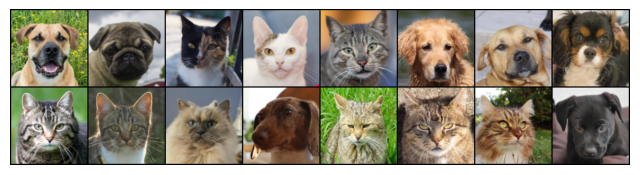

In [7]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.imshow(np.transpose(utils.make_grid(real_batch[0].to(device)[:16], ncol=4, padding=2, normalize=True).cpu(), (1,2,0)))

In [25]:
class generator(nn.Module):
    def __init__(self, c=256):
        super(generator, self).__init__()
        
        self.noiseSeq = nn.Sequential(
            nn.ConvTranspose2d(rand_size, c, 4, 1, 0), # (100, 1, 1) => (256, 4, 4)
            nn.BatchNorm2d(c),
            nn.LeakyReLU(0.2)
        )
        self.labelSeq = nn.Sequential(
            nn.ConvTranspose2d(num_class, c, 4, 1, 0), # (2, 1, 1) => (256, 4, 4)
            nn.BatchNorm2d(c),
            nn.LeakyReLU(0.2)
        )
        
        self.sequence = nn.Sequential(            
            nn.ConvTranspose2d(c * 2, c, 4, 2, 1),
            nn.BatchNorm2d(c),
            nn.LeakyReLU(True), # 4 * 4 => 8 * 8
            
            nn.ConvTranspose2d(c, c // 2, 4, 2, 1),
            nn.BatchNorm2d(c // 2),
            nn.LeakyReLU(True), # 16 * 16
            
            nn.ConvTranspose2d(c // 2, c // 2, 4, 2, 1),
            nn.BatchNorm2d(c // 2),
            nn.LeakyReLU(True), # 32 * 32
            
            nn.ConvTranspose2d(c // 2, c // 4, 4, 2, 1),
            nn.BatchNorm2d(c // 4),
            nn.LeakyReLU(True), # 64 * 64
            
            nn.ConvTranspose2d(c // 4, 3, 4, 2, 1),
            nn.Tanh() # 128 * 128
        )
    
    def forward(self, noise, label): # noise: (b, 100, 1, 1), label: (b, 2, 1, 1)
        return self.sequence(torch.cat([self.noiseSeq(noise), self.labelSeq(label)], 1)) # (b, 256 * 2, 4, 4)

In [26]:
netG = generator().to(device)
n = torch.randn(batch_size, rand_size, device=device).view(-1, 100, 1, 1)
l = torch.randn(batch_size, num_class, device=device).view(-1, num_class, 1, 1)
print(netG(n, l).size())
print(netG)

torch.Size([128, 3, 128, 128])
generator(
  (noiseSeq): Sequential(
    (0): ConvTranspose2d(100, 256, kernel_size=(4, 4), stride=(1, 1))
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
  )
  (labelSeq): Sequential(
    (0): ConvTranspose2d(2, 256, kernel_size=(4, 4), stride=(1, 1))
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
  )
  (sequence): Sequential(
    (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=True)
    (3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=True)
    (6): ConvTranspose2d(128, 128, kernel_si

In [13]:
class discriminator(nn.Module):
    def __init__(self, c=64):
        super(discriminator, self).__init__()
        
        self.imageSeq = nn.Sequential(
            nn.Conv2d(3, c, 4, 2, 1), # (b, 3, 128, 128) => (b, 64, 64, 64)
            nn.LeakyReLU(0.2)
        )
        self.labelSeq = nn.Sequential(
            nn.Conv2d(num_class, c, 4, 2, 1), # (b, 2, 128, 128) => (b, 64, 64, 64)
            nn.LeakyReLU(0.2)
        )
        
        self.sequence = nn.Sequential(
            nn.Conv2d(c * 2, c * 2, 4, 2, 1),
            nn.BatchNorm2d(c * 2),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(c * 2, c * 4, 4, 2, 1),
            nn.BatchNorm2d(c * 4),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(c * 4, c * 8, 4, 2, 1),
            nn.BatchNorm2d(c * 8),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(c * 8, c * 8, 4, 2, 1),
            nn.BatchNorm2d(c * 8),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(c * 8, 1, 4, 1, 0),
            nn.Sigmoid()
        )
        
    def forward(self, image, label):
        return self.sequence(torch.cat([self.imageSeq(image), self.labelSeq(label)], 1))

In [14]:
netD = discriminator().to(device)
i = torch.randn(batch_size, 3, 128, 128, device=device)
l = torch.ones(batch_size, num_class, 128, 128, device=device)
print(netD(i, l).size())
print(netD)

torch.Size([128, 1, 1, 1])
discriminator(
  (imageSeq): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2)
  )
  (labelSeq): Sequential(
    (0): Conv2d(2, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2)
  )
  (sequence): Sequential(
    (0): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
    (3): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2)
    (6): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2)
    (9): Conv2d(512, 512, ke

In [49]:
criterion = nn.BCELoss()

real_label = 1
fake_label = 0

fixed_noise = torch.randn(128, rand_size, 1, 1, device=device)

beta1 = 0.5
optD = opt.Adam(netD.parameters(), lr=0.0002, betas=(beta1, 0.999))
optG = opt.Adam(netG.parameters(), lr=0.0002, betas=(beta1, 0.999))

num_epochs = 500

In [50]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        
        ##
        torch.autograd.set_detect_anomaly(True)
        ##
        
        # Training D
        
        ## real data
        netD.zero_grad()

        image = data[0].to(device) # (128, 3, 128, 128)
        b_size = image.size(0)
        
        label_real = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        label_fake = torch.full((b_size,), fake_label, dtype=torch.float, device=device)
        
        label_D = torch.zeros(b_size, num_class, 128, 128, device=device)
        for k in range(b_size):
            label_D[k, data[1][k]] = torch.ones(128, 128, device=device)
        
        outD_real = netD(image, label_D).view(-1) # training Disc with real image + class label
        errD_real = criterion(outD_real, label_real)   # Crit Disc with output of Disc + real label(filled with 1)
        
        #errD_real.backward()
        
        D_x = outD_real.mean().item() # 1에 가까울 수록 Classification 잘 한 것
        

        ## fake data
        #label.fill_(fake_label)
        
        noise = torch.randn(b_size, rand_size, 1, 1, device=device)
        label_G = torch.zeros(b_size, num_class, 1, 1, device=device)
        for k in range(b_size):
            label_G[k, data[1][k]] = torch.ones(1, 1, device=device)
        
        fake = netG(noise, label_G)
        
        outD_fake = netD(fake, label_D).view(-1) # fake input + class label을 Disc에 투입
        errD_fake = criterion(outD_fake, label_fake)  # Crit Disc with output of Disc + fake label(filled with 0)
        
        #errD_fake.backward() #retain_graph=True)
        
        D_G_z1 = outD_fake.mean().item() # 0에 가까워야 함
        
        errD = errD_real + errD_fake
        errD.backward(retain_graph=True)
        
        optD.step()

        
        # Training G

        netG.zero_grad()
        
        #label.fill_(real_label)
        
        output = netD(fake, label_D).view(-1) # update된 Disc에 다시 fake 투입
        errG = criterion(output, label_real)       # G는 output이 real(1)이 되게 학습해야 함
        
        errG.backward()
        
        D_G_z2 = output.mean().item() # 1에 가까워야 함
        
        optG.step()


        if i == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        G_losses.append(errG.item())
        D_losses.append(errD.item())

        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise[:b_size], label_G).detach().cpu()
            img_list.append(utils.make_grid(fake, padding=2, normalize=True))

        iters += 1
    

Starting Training Loop...
[0/500][0/86]	Loss_D: 0.0467	Loss_G: 22.1492	D(x): 1.0000	D(G(z)): 0.0374 / 0.0000
[1/500][0/86]	Loss_D: 0.2056	Loss_G: 17.4793	D(x): 0.9870	D(G(z)): 0.1543 / 0.0000
[2/500][0/86]	Loss_D: 1.5578	Loss_G: 29.6798	D(x): 1.0000	D(G(z)): 0.5664 / 0.0000
[3/500][0/86]	Loss_D: 0.0316	Loss_G: 7.5166	D(x): 0.9911	D(G(z)): 0.0214 / 0.0011
[4/500][0/86]	Loss_D: 0.0229	Loss_G: 12.7258	D(x): 0.9999	D(G(z)): 0.0141 / 0.0118
[5/500][0/86]	Loss_D: 0.0105	Loss_G: 7.0313	D(x): 0.9997	D(G(z)): 0.0100 / 0.0016
[6/500][0/86]	Loss_D: 0.0173	Loss_G: 9.3121	D(x): 1.0000	D(G(z)): 0.0158 / 0.0004
[7/500][0/86]	Loss_D: 0.0140	Loss_G: 6.3036	D(x): 0.9983	D(G(z)): 0.0118 / 0.0053
[8/500][0/86]	Loss_D: 1.8946	Loss_G: 29.8985	D(x): 1.0000	D(G(z)): 0.5461 / 0.0000
[9/500][0/86]	Loss_D: 0.0015	Loss_G: 9.4761	D(x): 0.9988	D(G(z)): 0.0003 / 0.0003
[10/500][0/86]	Loss_D: 5.4948	Loss_G: 39.9564	D(x): 1.0000	D(G(z)): 0.9782 / 0.0000
[11/500][0/86]	Loss_D: 0.0017	Loss_G: 8.0585	D(x): 0.9995	D(G(z))

[98/500][0/86]	Loss_D: 5.6234	Loss_G: 34.9051	D(x): 1.0000	D(G(z)): 0.9454 / 0.0000
[99/500][0/86]	Loss_D: 0.2102	Loss_G: 14.1476	D(x): 0.9999	D(G(z)): 0.1334 / 0.0001
[100/500][0/86]	Loss_D: 0.0261	Loss_G: 6.5543	D(x): 0.9823	D(G(z)): 0.0043 / 0.0050
[101/500][0/86]	Loss_D: 0.0120	Loss_G: 8.9205	D(x): 0.9892	D(G(z)): 0.0003 / 0.0008
[102/500][0/86]	Loss_D: 0.0167	Loss_G: 6.0280	D(x): 0.9931	D(G(z)): 0.0095 / 0.0034
[103/500][0/86]	Loss_D: 5.7586	Loss_G: 26.3900	D(x): 0.9999	D(G(z)): 0.7756 / 0.0000
[104/500][0/86]	Loss_D: 0.1674	Loss_G: 10.2697	D(x): 0.9912	D(G(z)): 0.1395 / 0.0002
[105/500][0/86]	Loss_D: 19.2235	Loss_G: 26.3159	D(x): 1.0000	D(G(z)): 0.9988 / 0.0000
[106/500][0/86]	Loss_D: 4.4368	Loss_G: 41.7304	D(x): 1.0000	D(G(z)): 0.9674 / 0.0000
[107/500][0/86]	Loss_D: 6.8100	Loss_G: 33.6273	D(x): 1.0000	D(G(z)): 0.9893 / 0.0000
[108/500][0/86]	Loss_D: 1.2532	Loss_G: 20.1574	D(x): 0.9999	D(G(z)): 0.4180 / 0.0000
[109/500][0/86]	Loss_D: 0.1544	Loss_G: 9.4985	D(x): 0.9992	D(G(z)): 0

[195/500][0/86]	Loss_D: 32.1008	Loss_G: 19.3406	D(x): 1.0000	D(G(z)): 0.9998 / 0.1960
[196/500][0/86]	Loss_D: 0.0952	Loss_G: 8.5249	D(x): 0.9805	D(G(z)): 0.0538 / 0.0010
[197/500][0/86]	Loss_D: 0.0010	Loss_G: 6.3222	D(x): 0.9999	D(G(z)): 0.0008 / 0.0030
[198/500][0/86]	Loss_D: 0.0070	Loss_G: 6.9752	D(x): 0.9990	D(G(z)): 0.0057 / 0.0016
[199/500][0/86]	Loss_D: 0.0310	Loss_G: 5.5358	D(x): 0.9853	D(G(z)): 0.0123 / 0.0051
[200/500][0/86]	Loss_D: 0.0059	Loss_G: 10.0886	D(x): 0.9951	D(G(z)): 0.0008 / 0.0001
[201/500][0/86]	Loss_D: 0.0041	Loss_G: 9.7363	D(x): 0.9961	D(G(z)): 0.0001 / 0.0002
[202/500][0/86]	Loss_D: 2.9376	Loss_G: 42.6285	D(x): 0.9996	D(G(z)): 0.8933 / 0.0000
[203/500][0/86]	Loss_D: 0.1999	Loss_G: 12.0002	D(x): 0.9959	D(G(z)): 0.1471 / 0.0001
[204/500][0/86]	Loss_D: 0.0390	Loss_G: 7.6526	D(x): 0.9836	D(G(z)): 0.0093 / 0.0047
[205/500][0/86]	Loss_D: 0.4098	Loss_G: 17.6428	D(x): 0.9997	D(G(z)): 0.2725 / 0.0001
[206/500][0/86]	Loss_D: 0.0151	Loss_G: 5.0863	D(x): 0.9922	D(G(z)): 0.

[292/500][0/86]	Loss_D: 2.5508	Loss_G: 13.3624	D(x): 1.0000	D(G(z)): 0.4471 / 0.0001
[293/500][0/86]	Loss_D: 6.5901	Loss_G: 25.6939	D(x): 1.0000	D(G(z)): 0.8853 / 0.0000
[294/500][0/86]	Loss_D: 0.1960	Loss_G: 9.1163	D(x): 0.9998	D(G(z)): 0.1440 / 0.0042
[295/500][0/86]	Loss_D: 5.7631	Loss_G: 36.3222	D(x): 1.0000	D(G(z)): 0.9520 / 0.0000
[296/500][0/86]	Loss_D: 0.0206	Loss_G: 5.2275	D(x): 0.9999	D(G(z)): 0.0191 / 0.0101
[297/500][0/86]	Loss_D: 13.4226	Loss_G: 17.4126	D(x): 1.0000	D(G(z)): 0.9993 / 0.0005
[298/500][0/86]	Loss_D: 1.4526	Loss_G: 29.1623	D(x): 0.9997	D(G(z)): 0.5118 / 0.0000
[299/500][0/86]	Loss_D: 4.6108	Loss_G: 31.6389	D(x): 0.9999	D(G(z)): 0.9701 / 0.0000
[300/500][0/86]	Loss_D: 0.0057	Loss_G: 5.8197	D(x): 0.9992	D(G(z)): 0.0049 / 0.0041
[301/500][0/86]	Loss_D: 5.1651	Loss_G: 37.9926	D(x): 1.0000	D(G(z)): 0.9863 / 0.0000
[302/500][0/86]	Loss_D: 0.5653	Loss_G: 19.5524	D(x): 0.9993	D(G(z)): 0.3847 / 0.0000
[303/500][0/86]	Loss_D: 0.0680	Loss_G: 6.0398	D(x): 0.9999	D(G(z)):

[389/500][0/86]	Loss_D: 0.0445	Loss_G: 5.6614	D(x): 0.9700	D(G(z)): 0.0074 / 0.0049
[390/500][0/86]	Loss_D: 3.2301	Loss_G: 38.1114	D(x): 1.0000	D(G(z)): 0.9287 / 0.0000
[391/500][0/86]	Loss_D: 5.2324	Loss_G: 33.8733	D(x): 1.0000	D(G(z)): 0.9478 / 0.0000
[392/500][0/86]	Loss_D: 1.1618	Loss_G: 20.2675	D(x): 1.0000	D(G(z)): 0.4458 / 0.0000
[393/500][0/86]	Loss_D: 0.0100	Loss_G: 5.7029	D(x): 0.9967	D(G(z)): 0.0066 / 0.0047
[394/500][0/86]	Loss_D: 0.5775	Loss_G: 20.0218	D(x): 0.9998	D(G(z)): 0.3420 / 0.0000
[395/500][0/86]	Loss_D: 0.0001	Loss_G: 11.9540	D(x): 1.0000	D(G(z)): 0.0001 / 0.0007
[396/500][0/86]	Loss_D: 9.1048	Loss_G: 29.1563	D(x): 1.0000	D(G(z)): 0.9948 / 0.0000
[397/500][0/86]	Loss_D: 8.8957	Loss_G: 26.4899	D(x): 1.0000	D(G(z)): 0.9973 / 0.0000
[398/500][0/86]	Loss_D: 0.5947	Loss_G: 19.6405	D(x): 0.9995	D(G(z)): 0.3755 / 0.0000
[399/500][0/86]	Loss_D: 0.1083	Loss_G: 8.0444	D(x): 0.9987	D(G(z)): 0.0964 / 0.0017
[400/500][0/86]	Loss_D: 3.8798	Loss_G: 38.2946	D(x): 1.0000	D(G(z)):

[486/500][0/86]	Loss_D: 1.2149	Loss_G: 25.1793	D(x): 0.9968	D(G(z)): 0.5771 / 0.0000
[487/500][0/86]	Loss_D: 0.1559	Loss_G: 7.3447	D(x): 0.9953	D(G(z)): 0.1148 / 0.0050
[488/500][0/86]	Loss_D: 0.9569	Loss_G: 29.8244	D(x): 0.9993	D(G(z)): 0.5129 / 0.0000
[489/500][0/86]	Loss_D: 0.2289	Loss_G: 14.8157	D(x): 0.9989	D(G(z)): 0.1892 / 0.0000
[490/500][0/86]	Loss_D: 0.0286	Loss_G: 5.7138	D(x): 0.9999	D(G(z)): 0.0275 / 0.0048
[491/500][0/86]	Loss_D: 0.0232	Loss_G: 8.0541	D(x): 0.9804	D(G(z)): 0.0003 / 0.0005
[492/500][0/86]	Loss_D: 12.4277	Loss_G: 18.7534	D(x): 1.0000	D(G(z)): 1.0000 / 0.0000
[493/500][0/86]	Loss_D: 4.9064	Loss_G: 33.2531	D(x): 1.0000	D(G(z)): 0.9606 / 0.0000
[494/500][0/86]	Loss_D: 0.0001	Loss_G: 38.4631	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000
[495/500][0/86]	Loss_D: 17.5516	Loss_G: 16.2314	D(x): 1.0000	D(G(z)): 0.9965 / 0.0236
[496/500][0/86]	Loss_D: 0.4768	Loss_G: 16.6878	D(x): 0.9989	D(G(z)): 0.2788 / 0.0000
[497/500][0/86]	Loss_D: 1.2231	Loss_G: 27.6356	D(x): 0.9999	D(G(z)

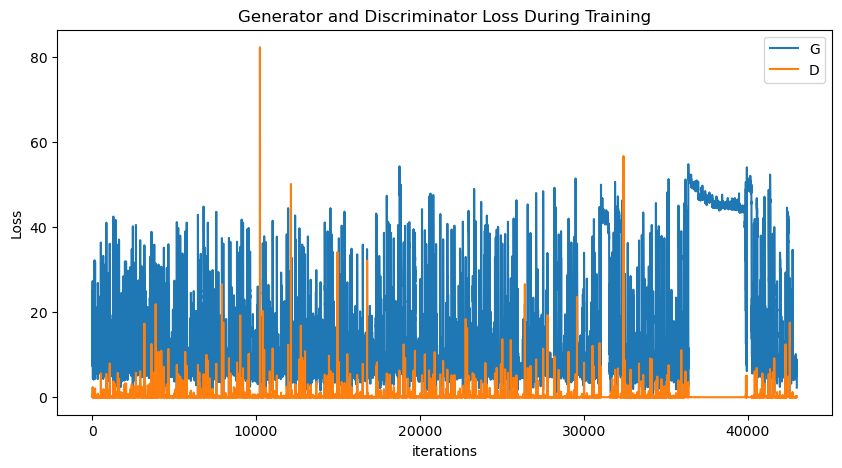

In [51]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21020020 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


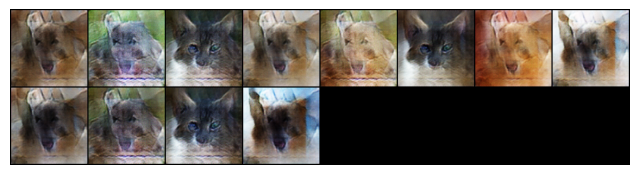

In [52]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [53]:
test_noise = torch.randn(64, rand_size, 1, 1, device=device)
test_label_cat = torch.zeros(64, 2, 1, 1, device=device)
test_label_cat[:, 0] = torch.ones(1,1)

test_label_dog = torch.zeros(64, 2, 1, 1, device=device)
test_label_dog[:, 1] = torch.ones(1,1)

test_label_catdog = torch.ones(64, 2, 1, 1, device=device)

In [54]:
test_cat = []
test_dog = []
test_catdog = []

with torch.no_grad():
    fake_cat = netG(test_noise, test_label_cat).detach().cpu()
    fake_dog = netG(test_noise, test_label_dog).detach().cpu()
    fake_catdog = netG(test_noise, test_label_catdog).detach().cpu()
    
test_cat.append(utils.make_grid(fake_cat, padding=2, normalize=True))
test_dog.append(utils.make_grid(fake_dog, padding=2, normalize=True))
test_catdog.append(utils.make_grid(fake_catdog, padding=2, normalize=True))

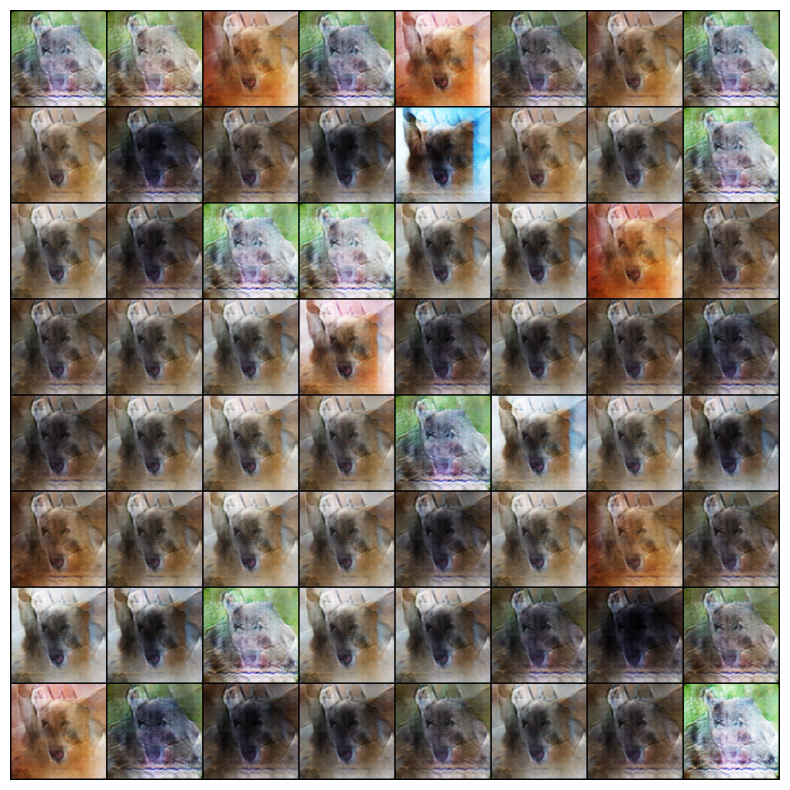

In [58]:
fig = plt.figure(figsize=(10,10))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in test_dog]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())